# Сегментация изображений

Выполнил: Гришин К. И.

In [27]:
import os

import cv2
import matplotlib.pyplot as plt

import numpy as np

## Задача
Реализовать на языке Python с использованием библиотеки OpenCV программу,
выполняющее сегментацию/кластеризацию изображения по цвету с использованием
метода K-Means.

# Входные данные

In [28]:
# Путь до входного изображения
image_path = "me.jpg"

# Количество кластеров
number_of_clusters = 5

def show_image(image):
    h, w = image.shape[:2]
    plt.figure(figsize=(w/150, h/150))
    plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    plt.show()

## Чтение изображения

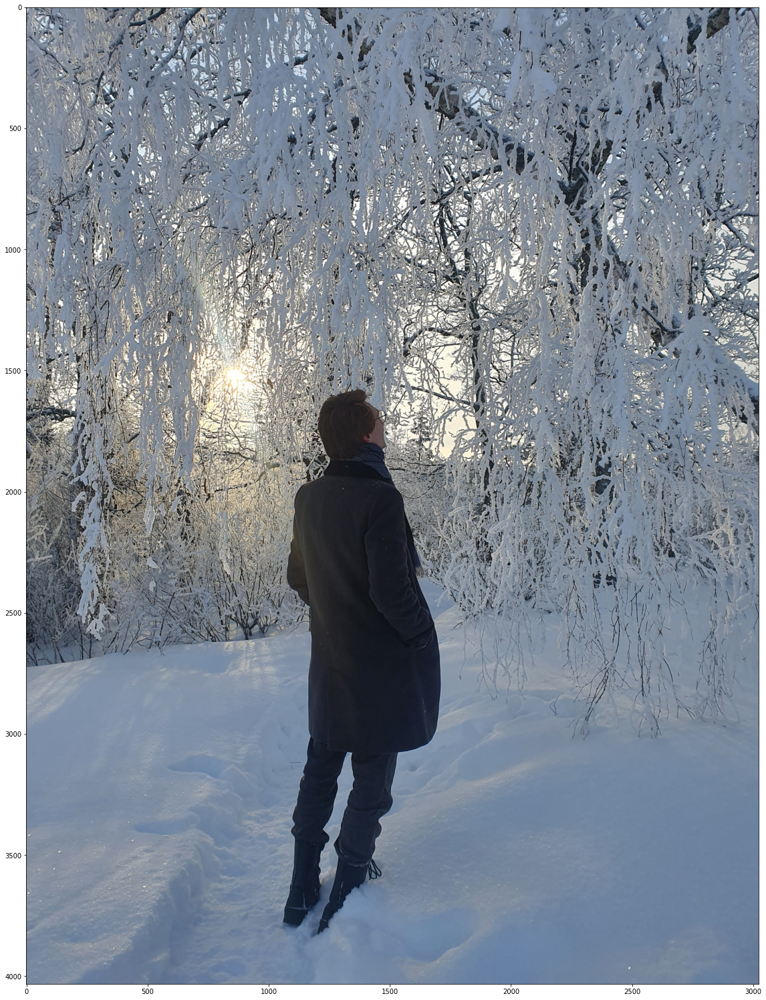

In [29]:
absoulte_path = os.path.abspath(image_path)
image = cv2.imread(absoulte_path)
show_image(image)

## Кластеризация K-Means

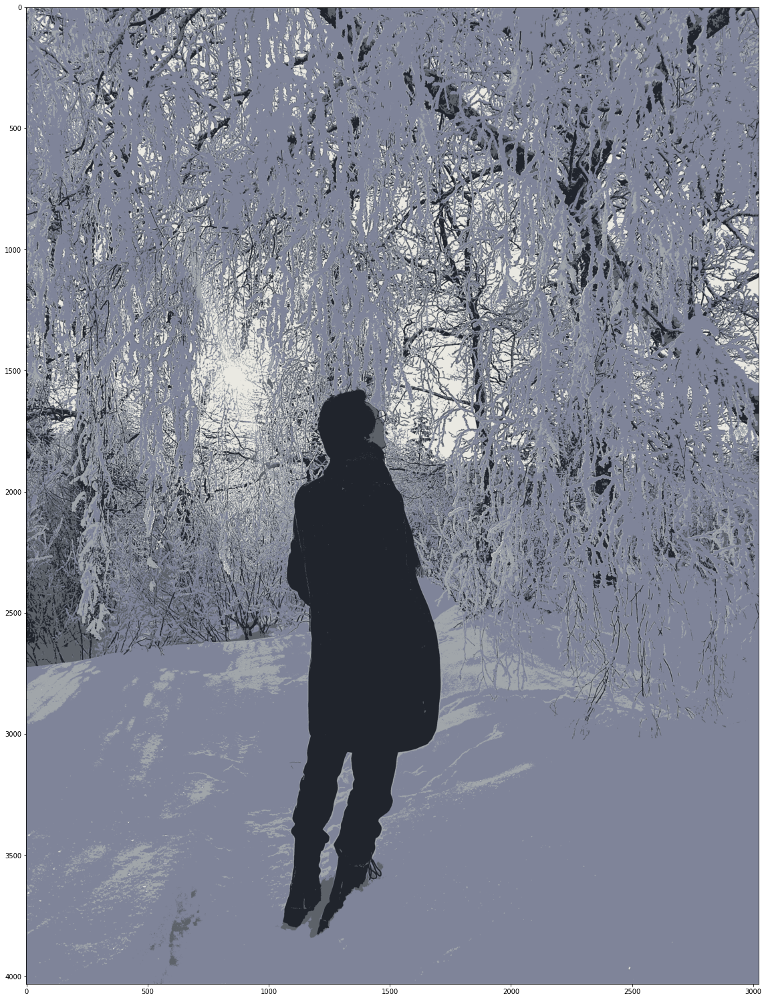

In [30]:
pixels = np.float32(image.reshape((-1, 3)))

criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 100, 0.2)

_, labels, (centers) = cv2.kmeans(pixels, number_of_clusters, None, criteria, 10, cv2.KMEANS_RANDOM_CENTERS)

centers = np.uint8(centers)

labels = labels.flatten()

segmented_image = centers[labels]
segmented_image = segmented_image.reshape(image.shape)

show_image(segmented_image)


# 

In [31]:
def darken_cluster(cluster_number):    
    masked_image = np.copy(image)
    masked_image = np.reshape(masked_image, (-1, 3))

    masked_image[labels == cluster_number] = [0, 0, 0]
    masked_image = masked_image.reshape(image.shape)

    show_image(masked_image)

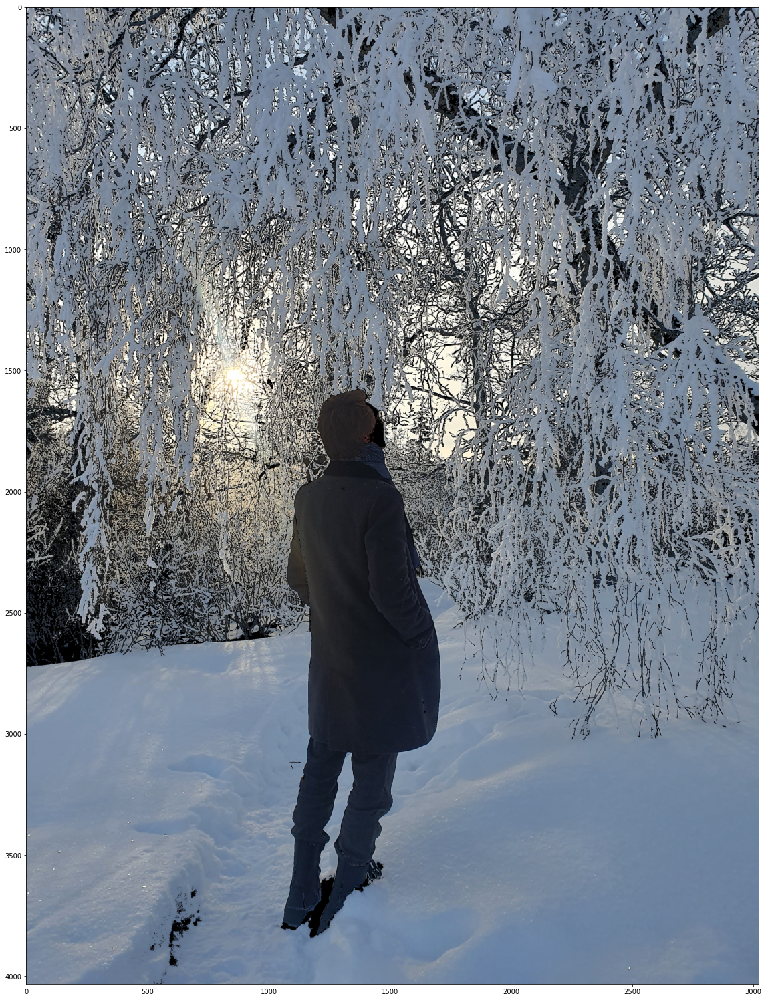

In [32]:
darken_cluster(0)

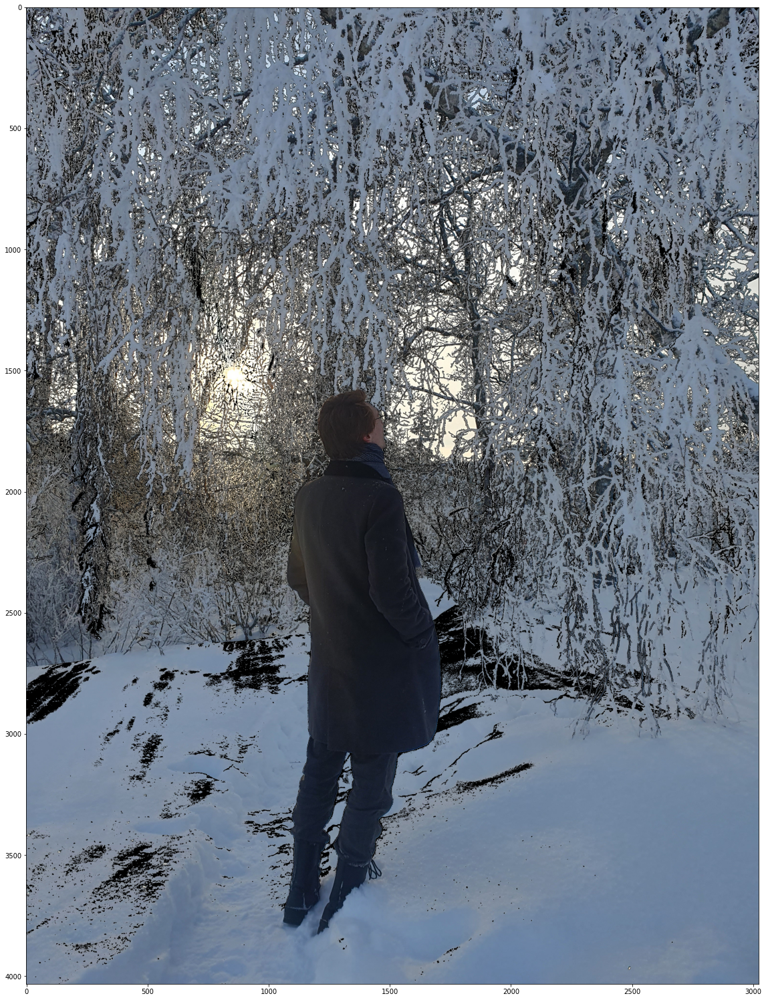

In [33]:
darken_cluster(1)

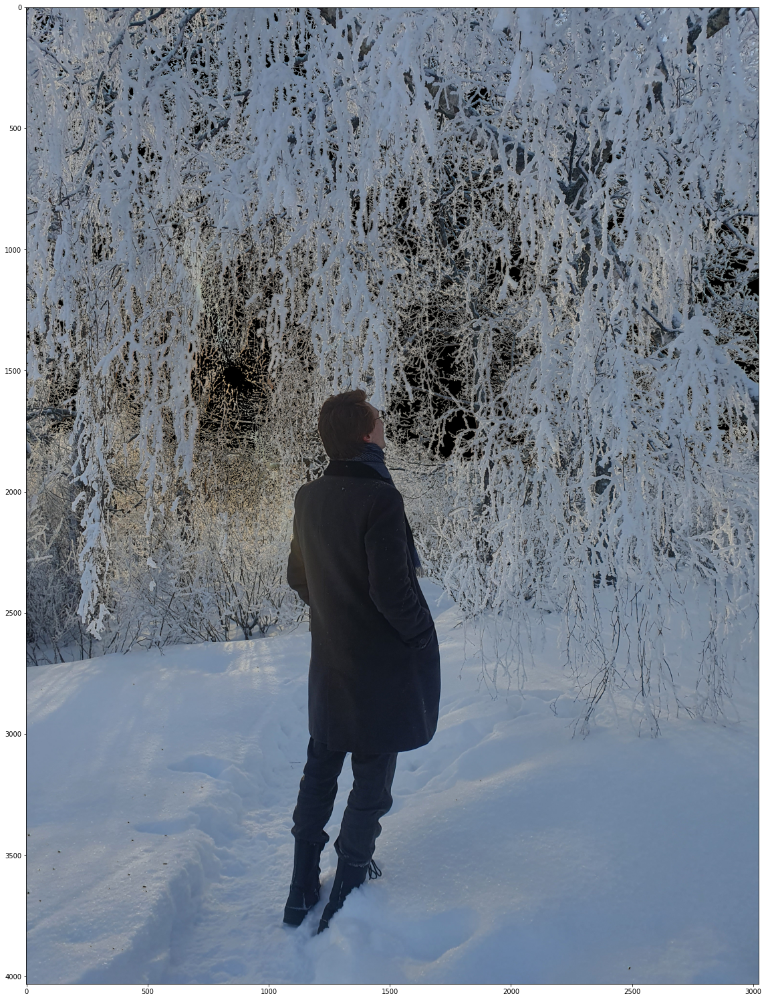

In [34]:
darken_cluster(2)

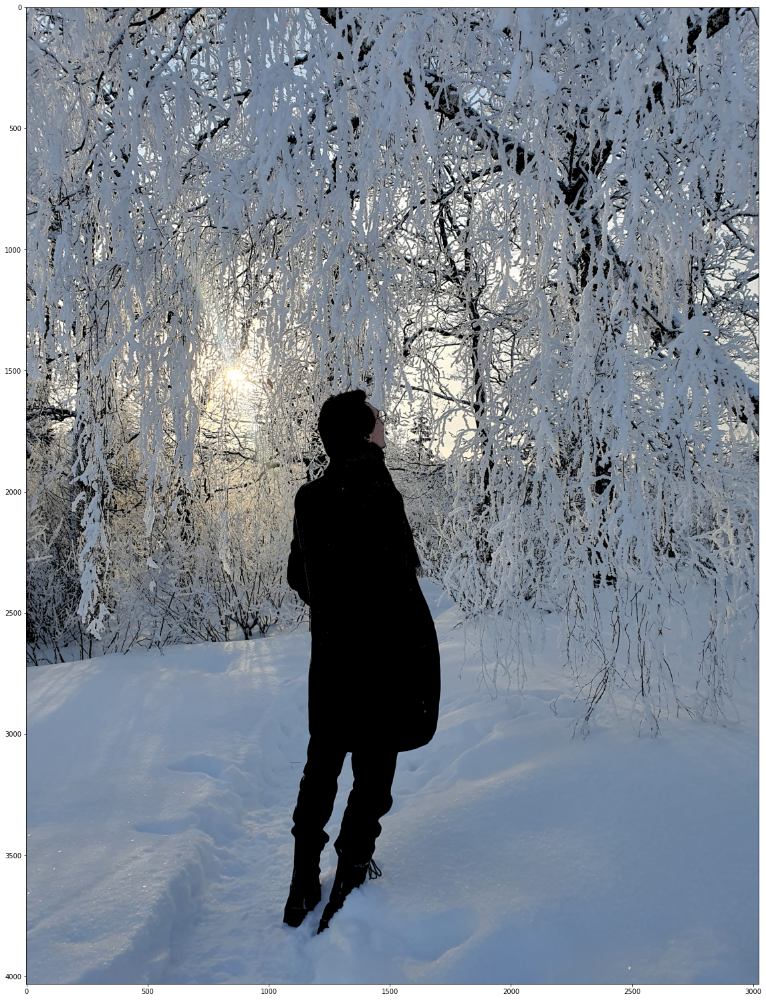

In [35]:
darken_cluster(3)